# EN.605.801 
# Independent Study in Computer Science

## Bayesian Approach to Sentiment Analysis Classification

This notebook intends to provide project status through 06/18/2020. 

&nbsp;

### The accomplished action items thus far:

 - Parsing and creation of unified raw dataset of famous IMBD NLP dataset
 - Creation of dataframes and split of both training and testing data of IMBD NLP dataset
 - Vectorization of IMBD dataset into tfidf, count, and boolean vectors
	 - For count and tfidf, values adjusted to reflect *-1 suggestion by Professor Johnson
 - Fitting function for normality complete
 - Initial fit of different classifiers to monitor performance
	 - Different naive bayes classifiers
 - Comparison of naive bayes performance against industry best practice (SVM)
     - Naive Bayes rivals SVM performance (delta < 2%)
 - Distributions of word metrics plotted
     - Observed Gaussian and Multinomial fits; correlates perfectly to performance

&nbsp;

### The following action items require additional work:

 - Fitting functions and code needs a bit of tweaking, some additional comments, cleaning up
 - Visuals for "fit" need to be created
 - Fitting documentation needs revision

# Resources Used (as of 06/17/2020)
&nbsp;

## Text Parsing
 - https://github.com/wundermahn/Yelp-Classification-ML
 
 &nbsp;
 
## NLP Resources
 - https://nlp.stanford.edu/IR-book/information-retrieval-book.html
 - https://nlp.stanford.edu/
 - https://www.nltk.org/
 
 &nbsp;
 
## ML / Classification Resources
 - https://scikit-learn.org/stable/modules/naive_bayes.html
 
 &nbsp;
 
## Academic Whitepapers
 - https://www.researchgate.net/publication/221650814_Spam_Filtering_with_Naive_Bayes_-_Which_Naive_Bayes
 - https://people.csail.mit.edu/jrennie/papers/icml03-nb.pdf
 - https://www.researchgate.net/publication/221439320_The_Optimality_of_Naive_Bayes
 - https://www.cs.cmu.edu/~knigam/papers/multinomial-aaaiws98.pdf
 - https://www.sciencedirect.com/science/article/pii/S2090447914000550
 
 &nbsp;
 
## Data
 - https://ai.stanford.edu/~amaas/data/sentiment/

In [1]:
# Perform all necessary imports

import pandas as pd, os, gc as gc, nltk, re, string 
import numpy as np, time, pickle, warnings, matplotlib.pyplot as plt, scipy.stats as st
from nltk.corpus import stopwords
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer
from nltk.stem.snowball import SnowballStemmer
from scipy.stats import binom, poisson
from scipy.optimize import curve_fit
from sklearn.model_selection import train_test_split
from sklearn.naive_bayes import GaussianNB, MultinomialNB, ComplementNB, BernoulliNB
from sklearn.svm import SVC # Per industry "best practice"

# Enable garbage collection, and filter warnings
gc.enable()
warnings.filterwarnings("ignore")

In [2]:
# Declare some functions that will be reused throughout the code base

# This function removes numbers from an array
def remove_nums(arr): 
    # Declare a regular expression
    pattern = '[0-9]'  
    # Remove the pattern, which is a number
    arr = [re.sub(pattern, '', i) for i in arr]    
    # Return the array with numbers removed
    return arr

# This function cleans the passed in paragraph and parses it
def get_words(para, stem):   
    # Create a set of stop words
    stop_words = set(stopwords.words('english'))
    # Split it into lower case    
    lower = para.lower().split()
    # Remove punctuation
    no_punctuation = (nopunc.translate(str.maketrans('', '', string.punctuation)) for nopunc in lower)
    # Remove integers
    no_integers = remove_nums(no_punctuation)
    # Remove stop words
    dirty_tokens = (data for data in no_integers if data not in stop_words)   
    # Ensure it is not empty
    tokens = [data for data in dirty_tokens if data.strip()]
    # Ensure there is more than 1 character to make up the word
    tokens = [data for data in tokens if len(data) > 1]
       
    if stem == True:
        # Perform stemming
        stemmer = SnowballStemmer('english')
        stemmed_tokens = [stemmer.stem(word) for word in tokens]
        return stemmed_tokens
    
    else:
        # Return the tokens
        return tokens 

# Function to build a dataframe from a given basepath
def build_df(path, basepath, df, classification):
    # Set the directory to scan equal to the path
    directory = os.fsencode(path)

    # Loop through all files in the directory
    for file in os.listdir(directory):
        # Assume a base utf-8 encoding
        temp_id = str(file.decode('utf-8'))
        # Open each file
        with open(basepath + temp_id, 'r', encoding="utf8") as curr:
            # Copy the text from the review
            temp_text = curr.read().replace('\n', '')
        # Build a new row for the dataframe
        data = [temp_id, temp_text, classification]
        # Add the row to the dataframe
        df.loc[len(df)] = data
        
        # Collect unused memory
        gc.collect()

    # Alert user to finish
    print("Done")
    
    # Return the completed dataframe
    return df

# Function to plot the distributions of each word in the df
def plot_df_distributions(df, name):
    # Loop through the df
    for col in df.columns:
        # Create a temp numpy array
        temp = df[col].to_numpy()
        # Plot the distribution
        n, bins, patches = plt.hist(temp, bins=3)
        # Set the title
        plt.suptitle("Data Type: {} | {} Distribution".format(str(name), str(col)))
        # Show the figure
        plt.show()

In [55]:
# # Build the initial dataset to toy with
#     ## NOTE - This is 25K of the 50K total reviews
#     ## This also is a perfectly even split of positive and negative sentiments
# neg_path = 'C:\\Users\\Kelly\\Desktop\\neg'
# pos_path = 'C:\\Users\\Kelly\\Desktop\\pos'
# neg_basepath = "C:\\Users\\Kelly\\Desktop\\neg\\"
# pos_basepath = "C:\\Users\\Kelly\\Desktop\\pos\\"

# df = pd.DataFrame(columns = ['ID', 'Text', 'Class'])

# df = build_df(neg_path, neg_basepath, df, -1)
# df = build_df(pos_path, pos_basepath, df, 1)

# gc.collect()
# df.to_csv('C:\\Users\\Kelly\\Desktop\\train_data.csv')

# gc.collect()

In [24]:
df = pd.read_csv('C:\\Users\\Kelly\\Desktop\\train_data.csv')

In [25]:
print(df.head(n=5))

   Unnamed: 0           ID                                               Text  \
0           0      0_3.txt  Story of a man who has unnatural feelings for ...   
1           1  10000_4.txt  Airport '77 starts as a brand new luxury 747 p...   
2           2  10001_4.txt  This film lacked something I couldn't put my f...   
3           3  10002_1.txt  Sorry everyone,,, I know this is supposed to b...   
4           4  10003_1.txt  When I was little my parents took me along to ...   

   Class  
0     -1  
1     -1  
2     -1  
3     -1  
4     -1  


In [4]:
classes = df['Class']

In [5]:
# Utilize pandas series to hold all of the text
s = pd.Series(df['Text'])
# Create a total corpus
corpus = s.apply(lambda s: ' '.join(get_words(s, True)))

In [6]:
# Create several vectorizers to determine what works best for this problem

# A boolean vectorizer, a tfidf vectorizer, and a count vectorizer
# boolean_vectorizer = CountVectorizer(strip_accents='unicode', 
#                                      binary=True)
# tfidf_vectorizer = TfidfVectorizer(strip_accents='unicode')
# count_vectorizer = CountVectorizer(strip_accents='unicode')
# tfidf = tfidf_vectorizer.fit_transform(corpus)
# count = count_vectorizer.fit_transform(corpus)
# boolean = boolean_vectorizer.fit_transform(corpus)

# Also, create trimmed instances, where a word must appear in more than 5% of all documents
# and no more than 99% of all documents
trimmed_boolean_vectorizer = CountVectorizer(strip_accents='unicode',
                                             min_df=1250, max_df = 0.99, 
                                             binary=True)
trimmed_tfidf_vectorizer = TfidfVectorizer(strip_accents='unicode', min_df=1250, max_df = 0.99)
trimmed_count_vectorizer = CountVectorizer(strip_accents='unicode', min_df=1250, max_df = 0.99)

trimmed_tfidf = trimmed_tfidf_vectorizer.fit_transform(corpus)
trimmed_count = trimmed_count_vectorizer.fit_transform(corpus)
trimmed_boolean = trimmed_boolean_vectorizer.fit_transform(corpus)

In [7]:
# Now, apply each of these vectorizers to the data and create dataframes

# Non trimmed
# boolean_df = pd.DataFrame(data = boolean.todense(), columns = boolean_vectorizer.get_feature_names())
# tfidf_df = pd.DataFrame(data = tfidf.todense(), columns = tfidf_vectorizer.get_feature_names())
# count_df = pd.DataFrame(data = count.todense(), columns = count_vectorizer.get_feature_names())

gc.collect()

# Trimmed
trimmed_boolean_df = pd.DataFrame(data = trimmed_boolean.todense(), columns = trimmed_boolean_vectorizer.get_feature_names())
trimmed_tfidf_df = pd.DataFrame(data = trimmed_tfidf.todense(), columns = trimmed_tfidf_vectorizer.get_feature_names())
trimmed_count_df = pd.DataFrame(data = trimmed_count.todense(), columns = trimmed_count_vectorizer.get_feature_names())

gc.collect()

0

In [26]:
print(trimmed_boolean_df.head(n=5))

   absolut  act  action  actor  actress  actual  age  almost  along  also  \
0        0    0       0      0        0       0    0       0      0     0   
1        0    1       1      0        0       1    0       1      1     1   
2        0    0       0      1        1       0    0       0      0     0   
3        0    0       0      0        0       0    0       0      0     0   
4        0    0       0      0        0       0    0       0      1     0   

   ...  write  writer  written  wrong  year  yes  yet  young  your  \
0  ...      0       0        0      0     0    0    0      0     0   
1  ...      0       0        0      0     0    0    0      0     0   
2  ...      0       0        0      0     0    0    0      0     0   
3  ...      0       0        0      0     0    0    0      0     0   
4  ...      0       0        0      0     0    0    0      0     1   

   classification  
0               0  
1               0  
2               0  
3               0  
4               

In [ ]:
# Now that the dataframes are built, adjust their values per Professor Johnson's instructions
# List of all dataframes
# dfs = [boolean_df, tfidf_df, count_df]
# names = ['Boolean', 'TFIDF', 'Count']

# for df in dfs:
#     df['classification'] = classes


# # Loop through the dfs
# for df in dfs:
#     # Multiply the values by *-1 if the sentiment was negative
#     df.update(df.drop('classification',axis=1).mul(df.classification,axis=0)[df.classification.eq(-1)])
#     # Free up some memory
#     gc.collect()

In [8]:
new_dfs = [trimmed_boolean_df, trimmed_tfidf_df, trimmed_count_df]
new_names = ['Trimmed_Boolean', 'Trimmed_TFIDF', 'Trimmed_Count']

for df in new_dfs:
    df['classification'] = classes


# Loop through the dfs
for df in new_dfs:
    # Multiply the values by *-1 if the sentiment was negative
    df.update(df.drop('classification',axis=1).mul(df.classification,axis=0)[df.classification.eq(-1)])
    # Free up some memory
    gc.collect()

In [9]:
# Now, replace the -1 classifications with 0

# Loop through the dataframes
for df in new_dfs:
    # Replace -1 with 0
    df['classification'].replace(-1, 0)

In [10]:
# Compare sizes

# Rows/Cols
print("Untrimmed Rows: {} Untrimmed Cols: {}".format(boolean_df.shape[0], boolean_df.shape[1]))
print("Trimmed Rows: {} Trimmed Cols: {}".format(trimmed_boolean_df.shape[0], trimmed_boolean_df.shape[1]))

NameError: name 'boolean_df' is not defined

In [12]:
# Basic statistics of each dataframe

# Loop through each df
for i in range(len(new_dfs)):
    # Use pandas describe function
    print("Evaluating: {}".format(new_names[i]))
    print(new_dfs[i].describe())
    print("*--------------------------------------------*")
    gc.collect()

Evaluating: Trimmed_Boolean
            absolut           act        action         actor      actress  \
count  25000.000000  25000.000000  25000.000000  25000.000000  25000.00000   
mean      -0.008760     -0.050480      0.005360     -0.011320      0.00208   
std        0.259164      0.509688      0.308245      0.443351      0.22378   
min       -1.000000     -1.000000     -1.000000     -1.000000     -1.00000   
25%        0.000000      0.000000      0.000000      0.000000      0.00000   
50%        0.000000      0.000000      0.000000      0.000000      0.00000   
75%        0.000000      0.000000      0.000000      0.000000      0.00000   
max        1.000000      1.000000      1.000000      1.000000      1.00000   

             actual          age        almost         along          also  \
count  25000.000000  25000.00000  25000.000000  25000.000000  25000.000000   
mean      -0.022200      0.01340     -0.000080      0.006840      0.046040   
std        0.397132      0.22703   

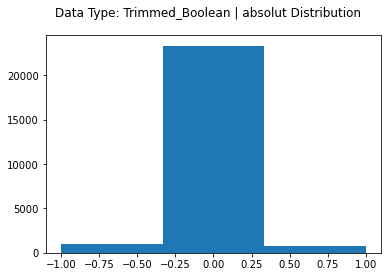

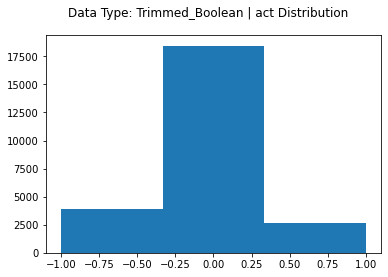

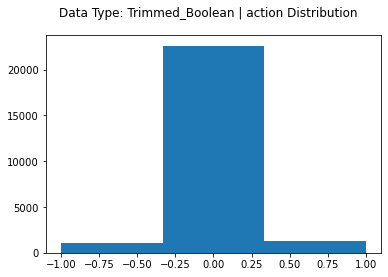

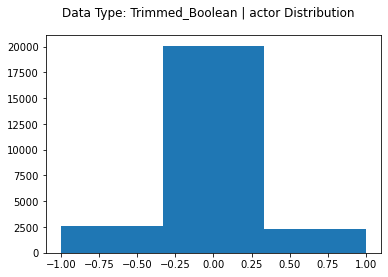

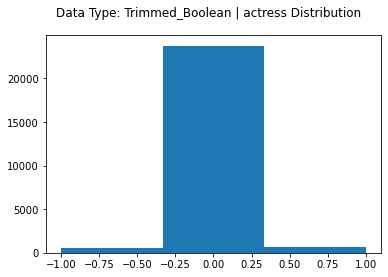

...

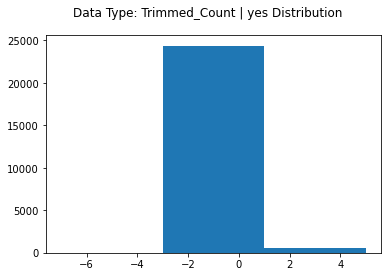

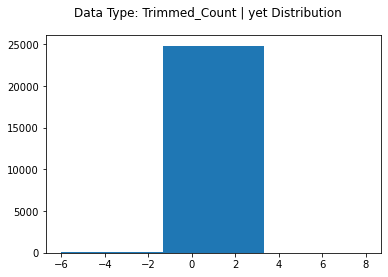

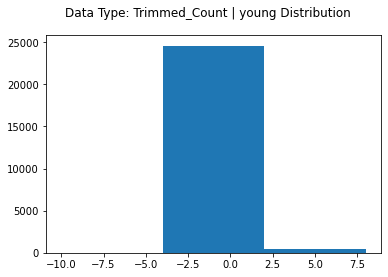

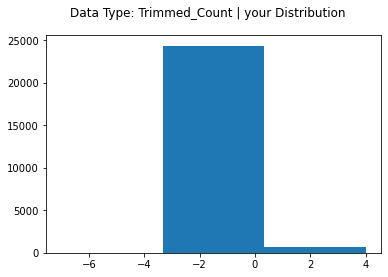

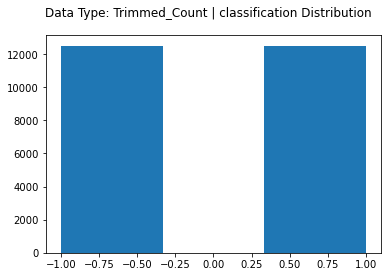

In [13]:
# Get some quick plots to show the distributions of each word in each dataset
for i in range(len(new_dfs)):
    plot_df_distributions(new_dfs[i], new_names[i])    

In [14]:
# Test some basic classifiers

# Declare a list of classifiers to try
classifiers = [GaussianNB(), MultinomialNB(), BernoulliNB(), 
               SVC(C=1.0, kernel='linear', degree=3, gamma='auto')]

# Loop through each of the datasets
for i in range(len(new_dfs)):
    print("*--------------------------------------------*")
    classes = new_dfs[i]['classification']
    new_dfs[i].drop('classification', inplace=True, axis=1)
    # Split the dataframe into training and test
    X_train, X_test, y_train, y_test = train_test_split(new_dfs[i], classes, test_size=0.3, random_state=np.random.randint(1,100))
    
    # Try each classifier
    for clf in classifiers:
        try:
            clf.fit(X_train, y_train)
            print("Data: {} | Classifier: {} | Score: {}".format(new_names[i], str(clf.__class__.__name__), clf.score(X_test, y_test)))
        except:
            print("Error Calculating: {}".format(str(clf.__class__.__name__)))

*--------------------------------------------*
Data: Trimmed_Boolean | Classifier: GaussianNB | Score: 0.9998666666666667
Error Calculating: MultinomialNB
Data: Trimmed_Boolean | Classifier: BernoulliNB | Score: 0.9989333333333333
Data: Trimmed_Boolean | Classifier: SVC | Score: 1.0
*--------------------------------------------*
Data: Trimmed_TFIDF | Classifier: GaussianNB | Score: 0.9918666666666667
Error Calculating: MultinomialNB
Data: Trimmed_TFIDF | Classifier: BernoulliNB | Score: 0.9992
Data: Trimmed_TFIDF | Classifier: SVC | Score: 1.0
*--------------------------------------------*
Data: Trimmed_Count | Classifier: GaussianNB | Score: 0.9949333333333333
Error Calculating: MultinomialNB
Data: Trimmed_Count | Classifier: BernoulliNB | Score: 0.9989333333333333
Data: Trimmed_Count | Classifier: SVC | Score: 1.0


### ISSUE
Naturally, because of the type of probability kernel that a multinomial fit uses, negative values don't work nearly as well. So, this was re-run using ***non negative values***. First, that needed to be recreated.

In [18]:
# Trimmed
trimmed_boolean_df = pd.DataFrame(data = trimmed_boolean.todense(), columns = trimmed_boolean_vectorizer.get_feature_names())
trimmed_tfidf_df = pd.DataFrame(data = trimmed_tfidf.todense(), columns = trimmed_tfidf_vectorizer.get_feature_names())
trimmed_count_df = pd.DataFrame(data = trimmed_count.todense(), columns = trimmed_count_vectorizer.get_feature_names())

del(new_dfs)
del(new_names)

gc.collect()

new_dfs = [trimmed_boolean_df, trimmed_tfidf_df, trimmed_count_df]
new_names = ['Trimmed_Boolean', 'Trimmed_TFIDF', 'Trimmed_Count']

In [19]:
# Convert -1 to 0 in the list of classes
classes = np.array(classes)
classes[classes==-1] = 0
# Ensure classes are now 0 and 1
print(set(list(classes)))

{0, 1}


In [20]:
# Now, add classification column to each df
for df in new_dfs:
    df['classification'] = classes

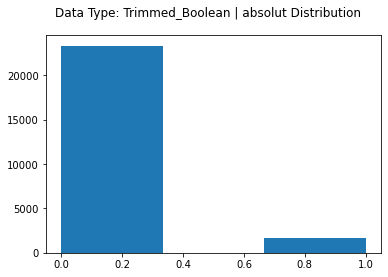

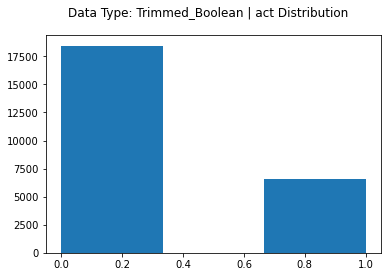

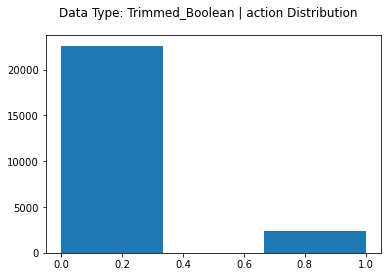

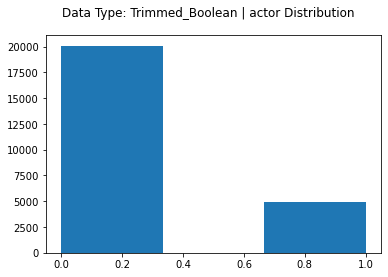

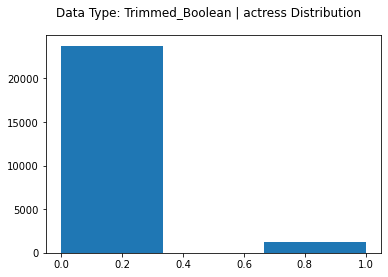

...

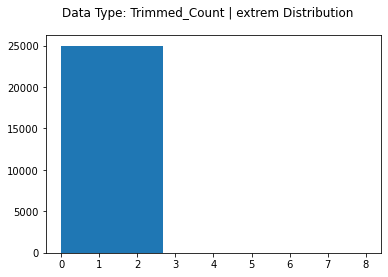

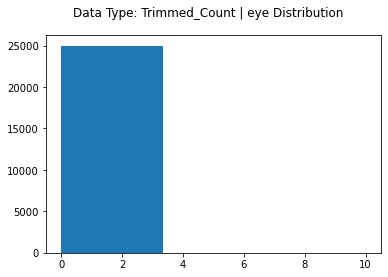

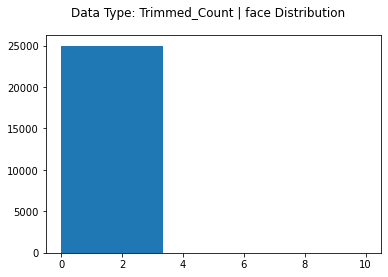

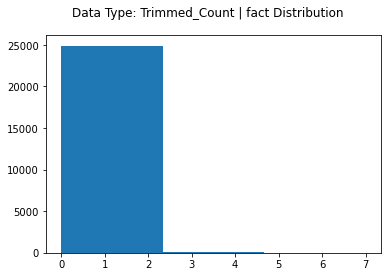

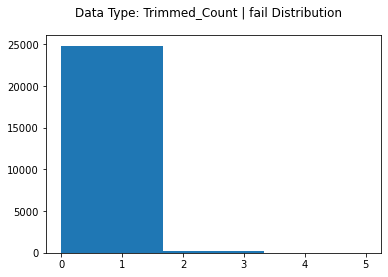

In [21]:
# Rerun the distributions
for i in range(len(new_dfs)):
    plot_df_distributions(new_dfs[i], new_names[i])   

In [22]:
# Let's rerun the classification

# Declare a list of classifiers to try
classifiers = [GaussianNB(), MultinomialNB(), BernoulliNB(), 
               SVC(C=1.0, kernel='linear', degree=3, gamma='auto')]

# Loop through each of the datasets
for i in range(len(new_dfs)):
    print("*--------------------------------------------*")    
    temp = new_dfs[i].copy()
    classes = temp['classification']
    temp.drop('classification', inplace=True, axis=1)
    # Split the dataframe into training and test
    X_train, X_test, y_train, y_test = train_test_split(temp, classes, test_size=0.3, random_state=np.random.randint(1,100))
    
    # Try each classifier
    for clf in classifiers:
        clf.fit(X_train, y_train)
        print("Data: {} | Classifier: {} | Score: {}".format(new_names[i], str(clf.__class__.__name__), clf.score(X_test, y_test)))
    gc.collect()

*--------------------------------------------*
Data: Trimmed_Boolean | Classifier: GaussianNB | Score: 0.8029333333333334
Data: Trimmed_Boolean | Classifier: MultinomialNB | Score: 0.8153333333333334
Data: Trimmed_Boolean | Classifier: BernoulliNB | Score: 0.8105333333333333
Data: Trimmed_Boolean | Classifier: SVC | Score: 0.8233333333333334
*--------------------------------------------*
Data: Trimmed_TFIDF | Classifier: GaussianNB | Score: 0.7905333333333333
Data: Trimmed_TFIDF | Classifier: MultinomialNB | Score: 0.8090666666666667
Data: Trimmed_TFIDF | Classifier: BernoulliNB | Score: 0.7994666666666667
Data: Trimmed_TFIDF | Classifier: SVC | Score: 0.8264
*--------------------------------------------*
Data: Trimmed_Count | Classifier: GaussianNB | Score: 0.7946666666666666
Data: Trimmed_Count | Classifier: MultinomialNB | Score: 0.808
Data: Trimmed_Count | Classifier: BernoulliNB | Score: 0.8036
Data: Trimmed_Count | Classifier: SVC | Score: 0.8277333333333333


## Testing Best Fit Distributions (Gaussian, Multinomial, Bernoulli)
This section requires some rework. The code needs to be tweaked and optimized, documentation needs to be created, and plots to demonstrate the fit need to be created. However, this code produces expected output.

In [ ]:
class BinomPMF:
    """Wrapper so that integer parameters don't occur as function arguments."""
    def __init__(self, n):
        self.n = n
    def __call__(self, ks, p):
        return binom(self.n, p).pmf(ks)

def fit_binom(hist, plot=False, weighted=True, f=1.5, verbose=False):
    hist = np.array(hist, dtype=float).ravel()
    #hist = np.array(hist, dtype=float)
    pmf = hist/hist.sum()
    nk = len(hist)
    if weighted:
        sigmas = np.sqrt(hist+0.25)/hist.sum()
    else:
        sigmas = np.full(nk, 1/np.sqrt(nk*hist.sum()))
    ks = np.arange(nk)
    mean = (pmf*ks).sum()
    variance = ((ks-mean)**2 * pmf).sum()

    # initial estimate for p and search range for n
    try:
        nest = max(1, int(mean**2 /(mean-variance) + 0.5))
    except:
        print("Mean: {} | Variance: {} | Mean-Variance: {}".format(mean, variance, mean-variance))
    nmin = max(1, int(nest/f))
    nmax = max(nmin, int(nest*f + 0.5))
    nvals = np.arange(nmin, nmax+1)
    num_n = nmax-nmin+1
    verbose and print(f'Initial estimate: n={nest}, p={mean/nest:.3g}')

    # store fit results for each n
    pvals, sses = np.zeros(num_n), np.zeros(num_n)
    for n in nvals:
        # fit and plot
        p_guess = max(0, min(1, mean/n))
        fitparams, _ = curve_fit(
            BinomPMF(n), ks, pmf, p0=p_guess, bounds=[0., 1.],
            sigma=sigmas, absolute_sigma=True)
        p = fitparams[0]
        sse = (((pmf - BinomPMF(n)(ks, p))/sigmas)**2).sum()
        verbose and print(f'  Trying n={n} -> p={p:.3g} (initial: {p_guess:.3g}),'
                          f' sse={sse:.3g}')
        pvals[n-nmin] = p
        sses[n-nmin] = sse
    n_fit = np.argmin(sses) + nmin
    p_fit = pvals[n_fit-nmin]
    if verbose:
        sse = sses[n_fit-nmin]
        print(f'  Found n={n_fit}, p={p_fit:.6g} sse={sse:.3g},'
              f' reduced chi^2={chi2r:.3g}')
    histf = BinomPMF(n_fit)(ks, p_fit) * hist.sum()

    if plot:    
        fig, ax = plt.subplots(2, 1, figsize=(4,4))
        ax[0].plot(ks, hist, 'ro', label='input data')
        ax[0].step(ks, histf, 'b', where='mid', label=f'fit: n={n_fit}, p={p_fit:.3f}')
        ax[0].set_xlabel('k')
        ax[0].axhline(0, color='k')
        ax[0].set_ylabel('Counts')
        ax[0].legend()

        ax[1].set_xlabel('n')
        ax[1].set_ylabel('sse')
        plotfunc = ax[1].semilogy if sses.max()>20*sses.min()>0 else ax[1].plot
        plotfunc(nvals, sses, 'k-', label='SSE over n scan')
        fig.show()

    return histf, n_fit, p_fit, sses[n_fit-nmin]

def fit_binom_samples(samples, f=1.5, weighted=True, verbose=False):
    """Convert array of samples (nonnegative ints) to histogram and fit.

    See fit_binom() for more explanation.
    """

    samples = np.array(samples, dtype=float)
    kmax = samples.max()
    #hist, _ = np.histogram(samples, 200)
    hist, _ = np.histogram(samples, np.arange(kmax+2)-0.5)
    return fit_binom(hist, f=f, weighted=weighted, verbose=verbose) 

def test_case(n, p, nsamp, weighted=True, f=1.5):
    """Run test with n, p values; nsamp=number of samples."""

    print(f'TEST CASE: n={n}, p={p}, nsamp={nsamp}')
    ks = np.arange(n+1) # bins
    pmf = BinomPMF(n)(ks, p)
    hist = poisson.rvs(pmf*nsamp)
    fit_binom(hist, weighted=weighted, f=f, verbose=True)
    
def gaussian_fit(data, bins=200):    
    data = np.array(data, dtype=float)
    kmax = data.max()
    y, x = np.histogram(data, np.arange(kmax+2)-0.5)
#     #bins = np.arange(len(data))
#    y, x = np.histogram(data, bins=bins, density=True)
    x = (x + np.roll(x, -1))[:-1] / 2.0

    params = st.norm.fit(data)
    arg = params[:-2]
    loc = params[-2]
    scale = params[-1]
    pdf = st.norm.pdf(x, loc=loc, scale=scale, *arg)
    sse = np.sum(np.power(y-pdf, 2.0))
    
    return sse

In [ ]:
def determine_best_fit(df, verbose=False):
    count_gauss = 0
    count_multi = 0
    count_berno = 0
    
    for col in df:
        temp = df[col].to_numpy()
        gaussian_sse = round(gaussian_fit(temp),5)
        histf, n_fit, p_fit, binom_sse = fit_binom_samples(temp)
        binom_sse = round(binom_sse, 5)
        if verbose:
            print("Word: {} | Gaussian SSE: {} | Binomial n: {} | Binomial SSE: {}".format(str(col), gaussian_sse, n_fit, binom_sse))
            
        if (gaussian_sse < binom_sse):
            count_gauss += 1
        else:
            if(n_fit==1):
                count_berno += 1
            else:
                count_multi += 1
    
    return count_gauss, count_berno, count_multi    

In [ ]:
# Test dataframes with negative values
for i in range(len(new_dfs)):
    count_gauss, count_berno, count_multi = determine_best_fit(new_dfs[i], verbose=False)
    print("Overall Distributions for: {} | Gaussian: {} | Multinomial: {} | Bernoulli: {}".format(names[i], count_gauss, count_multi, count_berno))

In [ ]:
# Test dataframes with negative values
for i in range(len(dfs)):
    count_gauss, count_berno, count_multi = determine_best_fit(dfs[i], verbose=False)
    print("Overall Distributions for: {} | Gaussian: {} | Multinomial: {} | Bernoulli: {}".format(names[i], count_gauss, count_multi, count_berno))